In [37]:
import torch
from matplotlib import pyplot as plt
import numpy as np
from PIL import Image


In [ ]:
def tensor_2d_para_imagem_colorida(tensor_2d, nome_arquivo="imagem_colorida.png", colormap='viridis'):
    """
    Converte um tensor 2D em uma imagem colorida e a salva.

    Args:
        tensor_2d (torch.Tensor ou np.ndarray): O tensor/array 2D de entrada.
        nome_arquivo (str): O nome do arquivo para salvar a imagem.
        colormap (str): O mapa de cores a ser usado (ex: 'viridis', 'plasma', 'jet', 'gray').
    """
    
    # 1. Converter tensor PyTorch para array NumPy, se necessário
    if isinstance(tensor_2d, torch.Tensor):
        array_2d = tensor_2d.cpu().numpy()
    else:
        array_2d = tensor_2d

    # 2. Normalizar os dados para o intervalo [0, 1] (se já não estiverem)
    # Isso é necessário para que o colormap funcione corretamente
    if array_2d.max() > 1.0 or array_2d.min() < 0.0:
        array_2d = (array_2d - array_2d.min()) / (array_2d.max() - array_2d.min())

    # 3. Aplicar o mapa de cores
    # O Matplotlib gera um array RGBA (4 canais: Vermelho, Verde, Azul, Alfa/Transparência)
    mapper = plt.get_cmap(colormap)
    array_rgba = mapper(array_2d)

    
    # Remover o canal alfa, resultando em RGB
    array_rgb = (array_rgba[:, :, :3] * 255).astype(np.uint8)

    # 4. Converter o array NumPy RGB em uma imagem PIL
    imagem = Image.fromarray(array_rgb, 'RGB')

    # 5. Salvar a imagem
    imagem.save(nome_arquivo)
    print(f"Imagem salva como '{nome_arquivo}'")
    return imagem   



In [ ]:
torch.manual_seed(43)

linear = torch.nn.Linear(3, 3, bias=True)

tensor_A = torch.Tensor([[1.0, 2.0, 3.0],
                         [4.0, 5.0, 6.0],
                         [7.0, 8.0, 9.0]])
print(tensor_A)
tensor_B = linear(tensor_A)

print(tensor_B)

tensor([[1., 2., 3.],
        [4., 5., 6.],
        [7., 8., 9.]])
tensor([[-0.6577, -0.5797,  0.6369],
        [-1.1670, -2.0570,  1.8222],
        [-1.6764, -3.5343,  3.0075]], grad_fn=<AddmmBackward0>)


In [79]:
torch.manual_seed(1234)
torch.cuda.manual_seed(1234)

A = torch.randn(2, 3, device='cuda')
B = torch.randn(2, 3, device='cuda')
print("Tensor A: ", A)
print("Tensor B: ", B)

Tensor A:  tensor([[-1.6165,  0.5685, -0.5102],
        [-0.9113, -1.1555, -0.2262]], device='cuda:0')
Tensor B:  tensor([[ 0.6331,  1.6358, -0.3459],
        [ 1.0196, -0.4122,  1.4279]], device='cuda:0')


In [ ]:
what_were_covering = {1: "data (prepare and load)",
    2: "build model",
    3: "fitting the model to data (training)",
    4: "making predictions and evaluating a model (inference)",
    5: "saving and loading a model",
    6: "putting it all together"
}

In [ ]:
from llm import Models0
import numpy as np
import matplotlib.pyplot as plt
models_0 = Models0()

In [ ]:

data = np.array([[1, 2], [3, 4], [5, 6]])
test_array = np.array([[7, 8], [9, 10]])
models_0.forward(data)

array([0.96067443, 1.23206688, 1.50345933])

In [8]:
epocs = 500
for epoch in range(epocs):
    models_0.backward()
    if epoch % 50 == 0:
        print(f"Epoch {epoch}/{epocs}")

Loss: -1.5358662445464095
Backward through layer: linear2
Output during forward: [array([0.96067443]), array([1.23206688]), array([1.50345933])]
dw: [0.11790951], db: [array([2.40197665]), array([4.70367778]), array([7.00537891])]
Layer result: [array([0.96067443]), array([1.23206688]), array([1.50345933])]
Derivative: (array([0.11972044]), [array([2.40197665]), array([4.70367778]), array([7.00537891])])
Backward through layer: linear1
Output during forward: [array([2.40197665]), array([4.70367778]), array([7.00537891])]
dw: [0.44051717 0.71033339], db: [[1 2]
 [3 4]
 [5 6]]
Layer result: [array([2.40197665]), array([4.70367778]), array([7.00537891])]
Derivative: (array([0.44728293, 0.72124316]), array([[1, 2],
       [3, 4],
       [5, 6]]))
Backward through layer: linear2
Output during forward: [array([0.96067443]), array([1.23206688]), array([1.50345933])]
dw: [0.11972044], db: [array([2.40197665]), array([4.70367778]), array([7.00537891])]
Layer result: [array([0.96067443]), array(

/home/prismoht/Desktop/diretorys/public/codes/tests/test4_pytoch/llm.py:263: RuntimeWarning: overflow encountered in multiply
  dtw = self.gradients[-1] * dw
/home/prismoht/Desktop/diretorys/public/codes/tests/test4_pytoch/llm.py:184: RuntimeWarning: invalid value encountered in subtract
  self.weights -= lr * dw


Output during forward: [array([1.50781186]), array([2.]), array([2.49218814])]
dw: [nan], db: [array([nan]), array([nan]), array([nan])]
Layer result: [array([nan]), array([nan]), array([nan])]
Derivative: (array([nan]), [array([nan]), array([nan]), array([nan])])
Backward through layer: linear1
Output during forward: [array([3.3462385]), array([6.44590966]), array([9.54558082])]
dw: [nan nan], db: [[1 2]
 [3 4]
 [5 6]]
Layer result: [array([nan]), array([nan]), array([nan])]
Derivative: (array([nan, nan]), array([[1, 2],
       [3, 4],
       [5, 6]]))
Backward through layer: linear2
Output during forward: [array([1.50781186]), array([2.]), array([2.49218814])]
dw: [nan], db: [array([nan]), array([nan]), array([nan])]
Layer result: [array([nan]), array([nan]), array([nan])]
Derivative: (array([nan]), [array([nan]), array([nan]), array([nan])])
Backward through layer: linear1
Output during forward: [array([3.3462385]), array([6.44590966]), array([9.54558082])]
dw: [nan nan], db: [[1 2]

KeyboardInterrupt: 

Predictions after training: [nan nan nan]


NameError: name 'test_array' is not defined

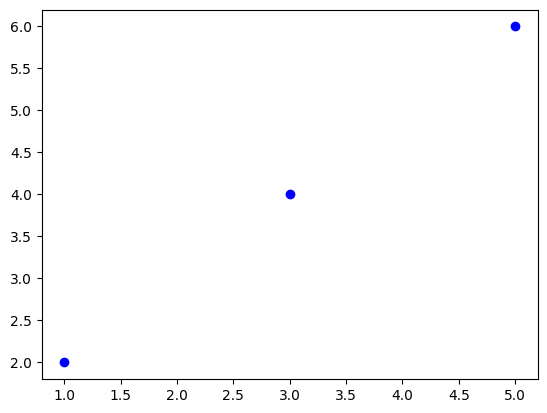

In [10]:
import matplotlib.pyplot as plt

predicsts = models_0.forward(data)
print(f"Predictions after training: {predicsts}")


plt.scatter(data[:, 0], data[:, 1], c='blue', label='Training Data')
plt.scatter(test_array[:, 0], test_array[:, 1], c='red', label='Test Data')
plt.plot(data[:, 0], predicsts, color='green', label='Model Predictions')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('Model Predictions vs Training Data')
plt.legend()
plt.show()